In [1]:
import numpy as np
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

In [2]:
# ✅ 모델 및 데이터 경로 설정
base_path = Path('output_image')
model_rgb = tf.keras.models.load_model(base_path / 'trained_model_best0.h5')

In [3]:
# ✅ 이미지 불러오기 및 전처리 함수
def load_and_preprocess_image(img_path):
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (112, 112))
    img = img / 255.0
    return img

In [4]:
def predict_folder_images(folder_path):
    folder_path = Path(folder_path)
    image_paths = list(folder_path.glob('*.jpg')) + list(folder_path.glob('*.png'))
    plt.figure(figsize=(20, 200))  # 전체 그래프 크기 축소
    
    for idx, image_path in enumerate(image_paths[:500]):  # 최대 500개 이미지만 시각화
        test_image = load_and_preprocess_image(image_path)
        test_image_batch = np.expand_dims(test_image, axis=0)
        
        # 예측 수행
        y_pred_probs = model_rgb.predict(test_image_batch)
        y_pred_label = 'Damaged' if y_pred_probs[0][0] > 0.5 else 'Normal'
        
        # 퍼센트로 변환하여 표시
        y_pred_percentage = y_pred_probs[0][0] * 100
        
        # 이미지 시각화 및 예측 결과 표시
        plt.subplot(100, 5, idx + 1)  # 한 줄에 5개, 총 100줄
        plt.imshow(test_image)
        plt.title(f"{image_path.name}\n{y_pred_label} ({y_pred_percentage:.2f}%)", fontsize=12)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 794ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━

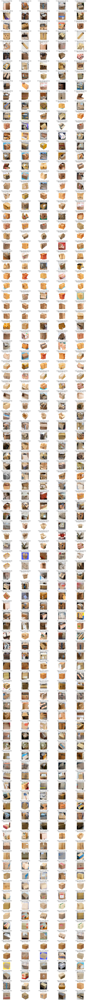

In [5]:
# ✅ 이미지 예측 실행
target_folder = base_path / 'box_test'
predict_folder_images(target_folder)

18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - accuracy: 0.8725 - loss: 0.3475
테스트 데이터 정확도: 87.21%
테스트 데이터 손실: 0.3370


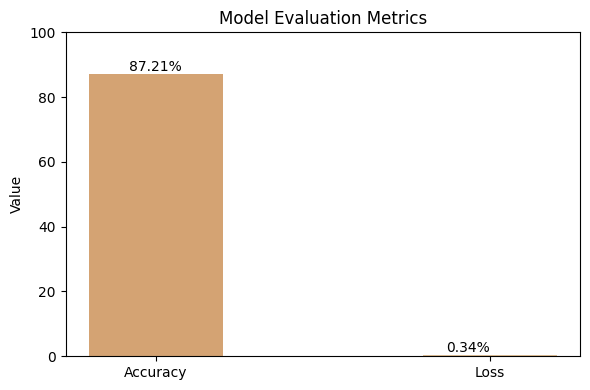

In [6]:
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import tensorflow as tf

# ✅ 경로 설정
model_path = Path('output_image/trained_model_best0.h5')
x_test_rgb = np.load('output_image/x_test_rgb_balanced.npy')
y_test = np.load('output_image/y_test_balanced.npy')

# ✅ 모델 로딩
model = tf.keras.models.load_model(model_path)

# ✅ 모델 평가 (정확도 및 손실)
loss, accuracy = model.evaluate(x_test_rgb, y_test, batch_size=32)

# ✅ 정확도와 손실 출력
print(f"테스트 데이터 정확도: {accuracy * 100:.2f}%")
print(f"테스트 데이터 손실: {loss:.4f}")

# ✅ 시각화 (정확도와 손실)
metrics = ['Accuracy', 'Loss']
values = [accuracy * 100, loss]

# ✅ 색상 팔레트 및 막대 너비 조정
colors = ['#d4a373', '#e0c097']  # 부드러운 갈색 계열
plt.figure(figsize=(6, 4))
plt.bar(metrics, values, color=colors, width=0.4)  # ✅ 막대 너비 조정
plt.ylabel('Value')
plt.title('Model Evaluation Metrics')
plt.ylim(0, 100 if max(values) > 1 else 1)

# ✅ 데이터 라벨 추가
for i, v in enumerate(values):
    plt.text(i, v + 1, f"{v:.2f}%", ha='center' if metrics[i] == 'Accuracy' else 'right')

plt.tight_layout()
plt.show()


18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 95ms/step


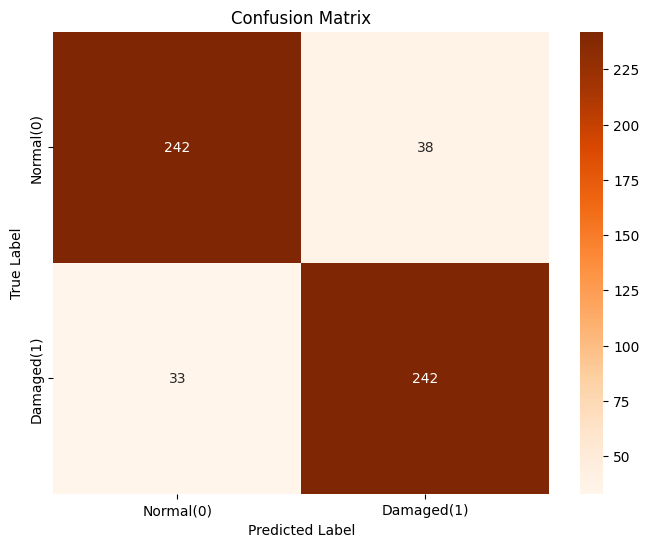

Classification Report:
              precision    recall  f1-score   support

   Normal(0)       0.88      0.86      0.87       280
  Damaged(1)       0.86      0.88      0.87       275

    accuracy                           0.87       555
   macro avg       0.87      0.87      0.87       555
weighted avg       0.87      0.87      0.87       555



In [7]:
# ✅ 경로 설정
model_path = Path('output_image/trained_model_best0.h5')
x_test_rgb = np.load('output_image/x_test_rgb_balanced.npy')
y_test = np.load('output_image/y_test_balanced.npy')

# ✅ 모델 로딩
model = tf.keras.models.load_model(model_path)

# ✅ 예측 수행
y_pred_probs = model.predict(x_test_rgb)  # 확률 값으로 예측
y_pred = (y_pred_probs > 0.5).astype(int).flatten()  # 0.5 기준으로 이진 분류 변환

# ✅ 혼동 행렬 계산
conf_matrix = confusion_matrix(y_test, y_pred)

# ✅ 혼동 행렬 시각화 (흰색 배경의 부드러운 색상 적용)
plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Oranges',
            xticklabels=['Normal(0)', 'Damaged(1)'],
            yticklabels=['Normal(0)', 'Damaged(1)'],
            cbar_kws={'format': '%.0f'})
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# ✅ 정밀도, 재현율, F1 점수 출력
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=['Normal(0)', 'Damaged(1)']))


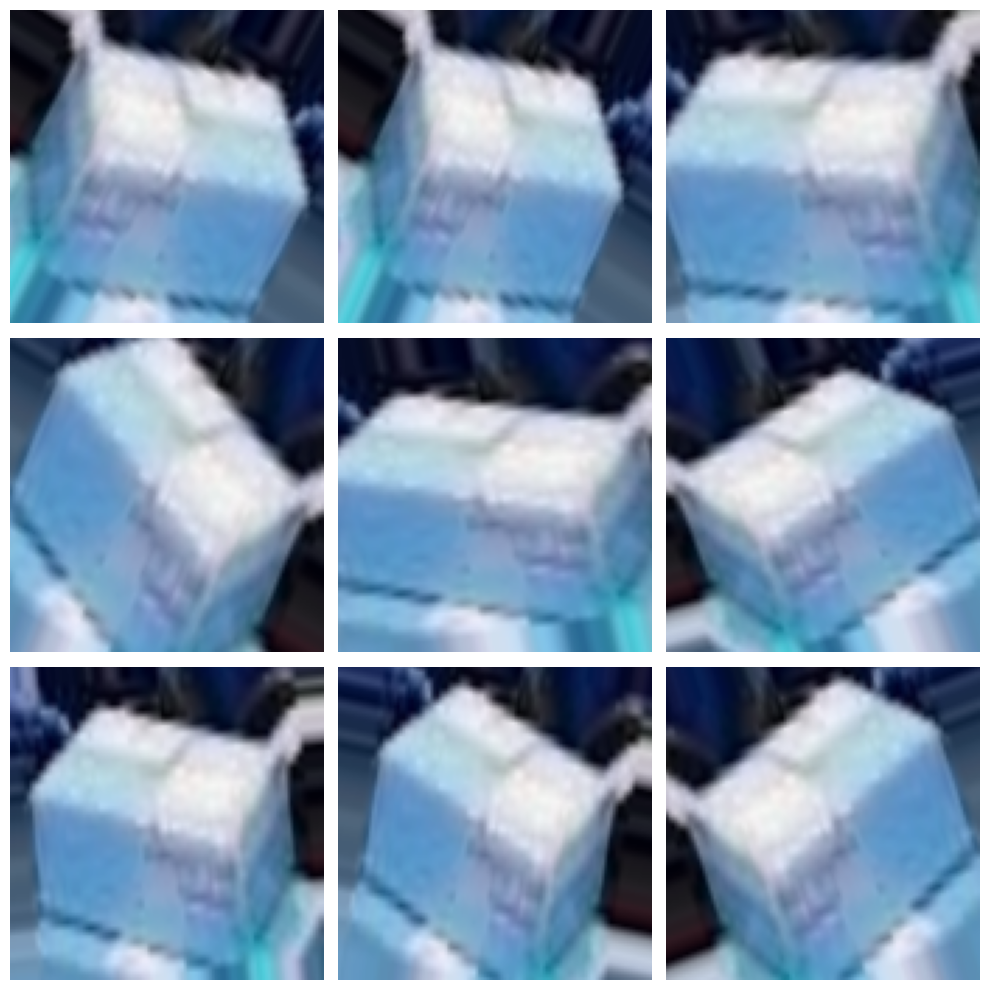

In [8]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator


# ✅ 데이터 로딩
x_train_rgb = np.load("output_image/x_train_rgb_balanced.npy")

# ✅ 정규화 해제 (0~1 범위를 0~255로 변환)
x_train_rgb = (x_train_rgb * 255).clip(0, 255).astype('uint8')

# ✅ 데이터 증강 설정
datagen = ImageDataGenerator(rotation_range=30, zoom_range=0.2, horizontal_flip=True)

# ✅ 데이터 증강 적용
augmented_images = datagen.flow(x_train_rgb[:9], batch_size=9, shuffle=False)

# ✅ 증강 데이터 시각화
plt.figure(figsize=(10,10))
for i in range(9):
    img_batch = augmented_images.__next__()
    img = img_batch[0].astype('uint8')  # 다시 uint8로 변환
    plt.subplot(3, 3, i + 1)
    plt.imshow(img)  
    plt.axis('off')
plt.tight_layout()
plt.show()

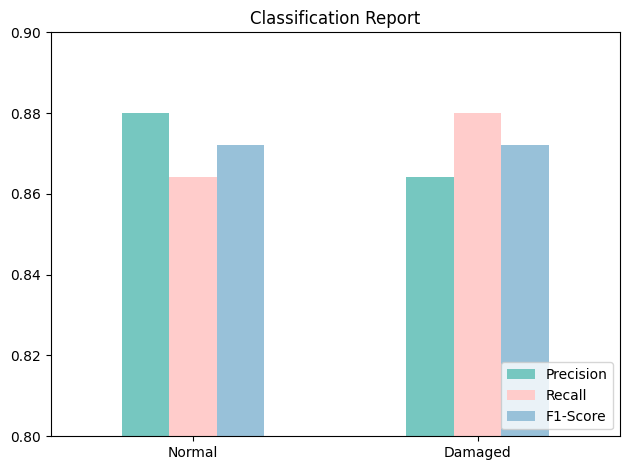

In [9]:
from sklearn.metrics import classification_report
import pandas as pd
import matplotlib.pyplot as plt

# 분류 보고서 생성 및 데이터프레임 변환
report = classification_report(y_test, y_pred, output_dict=True)
df = pd.DataFrame(report).transpose()

# 라벨 수정 (0 -> Normal, 1 -> Damaged)
df.rename(index={'0': 'Normal', '1': 'Damaged'}, inplace=True)

# 필요 없는 'accuracy', 'macro avg', 'weighted avg' 제거
df_filtered = df.drop(['accuracy', 'macro avg', 'weighted avg'])

# 시각화 (파스텔톤 색상 적용)
colors = ['#76c7c0', '#ffcccb', '#98c1d9']
df_filtered[['precision', 'recall', 'f1-score']].rename(
    columns={'precision': 'Precision', 'recall': 'Recall', 'f1-score': 'F1-Score'}
).plot(kind='bar', color=colors)

# 그래프 설정
plt.title('Classification Report')
plt.ylim([0.8, 0.9])  # 클로즈업 확대
plt.xticks(rotation=0)
plt.tight_layout()
plt.legend(loc='lower right')
plt.show()


Red Channel - Total: 2096416, Mean: 87.40529497602668
Green Channel - Total: 1763602, Mean: 73.52937252449448
Blue Channel - Total: 1449038, Mean: 60.41434229726913


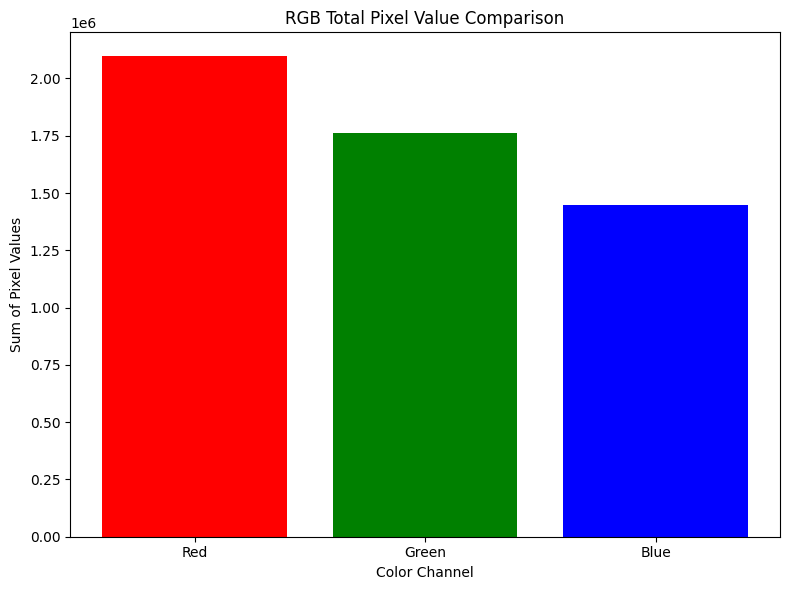

In [10]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# 이미지 데이터 경로
image_dir = r"output_image/box_damaged_1412"

# 데이터 저장 리스트 초기화
red_channel = []
green_channel = []
blue_channel = []

# 이미지 로딩 및 RGB 분리
for filename in os.listdir(image_dir):
    if filename.lower().endswith(('.jpg', '.png', '.jpeg', '.png')):
        image_path = os.path.join(image_dir, filename)
        try:
            # ✅ 이미지 로딩 (RGBA 변환 포함)
            with Image.open(image_path) as img:
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                
                # ✅ 데이터 추가를 덮어쓰기로 변경
                img_array = np.array(img)
                
                red_channel = img_array[:, :, 0].flatten()
                green_channel = img_array[:, :, 1].flatten()
                blue_channel = img_array[:, :, 2].flatten()
                
        except Exception as e:
            print(f"Error processing {filename}: {e}")

# ✅ 각 채널 총합 및 평균 계산
red_sum = np.sum(red_channel)
green_sum = np.sum(green_channel)
blue_sum = np.sum(blue_channel)

print(f"Red Channel - Total: {red_sum}, Mean: {np.mean(red_channel)}")
print(f"Green Channel - Total: {green_sum}, Mean: {np.mean(green_channel)}")
print(f"Blue Channel - Total: {blue_sum}, Mean: {np.mean(blue_channel)}")

# ✅ 픽셀 값 총합 그래프
plt.figure(figsize=(8, 6))
plt.bar(['Red', 'Green', 'Blue'], [red_sum, green_sum, blue_sum], color=['red', 'green', 'blue'])
plt.title('RGB Total Pixel Value Comparison')
plt.xlabel('Color Channel')
plt.ylabel('Sum of Pixel Values')
plt.tight_layout()
plt.show()
